<a href="https://colab.research.google.com/github/sarahatami/Object-Detection-with-YOLO/blob/master/Object_Detection_with_YOLO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install ultralytics

In [ ]:
import torch
import os
from PIL import Image as PILImage
from IPython.display import display, Markdown
from pathlib import Path
from PIL import Image
from tqdm import tqdm
import shutil
import kagglehub
import matplotlib.pyplot as plt
import ultralytics
from ultralytics import YOLO

In [ ]:
ultralytics.checks()

Ultralytics 8.3.221 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 39.7/112.6 GB disk)


**Run YOLO11 Nano on a Sample Image**

Ultralytics 8.3.221 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n summary (fused): 100 layers, 2,616,248 parameters, 0 gradients, 6.5 GFLOPs

image 1/1 /content/bus.jpg: 640x480 4 persons, 1 bus, 48.0ms
Speed: 11.4ms preprocess, 48.0ms inference, 6.9ms postprocess per image at shape (1, 3, 640, 480)
Results saved to /content/runs/detect/predict
💡 Learn more at https://docs.ultralytics.com/modes/predict


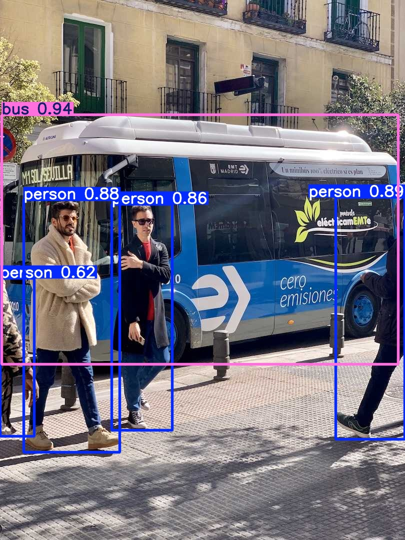

In [ ]:
!yolo predict model=yolo11n.pt conf=0.25 source='https://ultralytics.com/images/bus.jpg'
img = PILImage.open('/content/runs/detect/predict/bus.jpg')
w, h = img.size
resized = img.resize((w // 2, h // 2))
display(resized)

**Train YOLO11 Nano on Medical-Pills Dataset**

In [ ]:
!wget https://github.com/ultralytics/assets/releases/download/v0.0.0/Medical-Pills.zip
!unzip -q Medical-Pills.zip -d medical-pills/

In [ ]:
# Load pretrained YOLOv11 Nano model
model = YOLO("yolo11n.pt")

# Train on Medical-Pills
model.train(data="/content/medical-pills/medical-pills.yaml", epochs=50, imgsz=640, batch=16)

In [ ]:
# Validate
model.val()
model.predict(model="/content/runs/detect/train2/weights/best.pt" , source="/content/medical-pills/images/val", save=True)

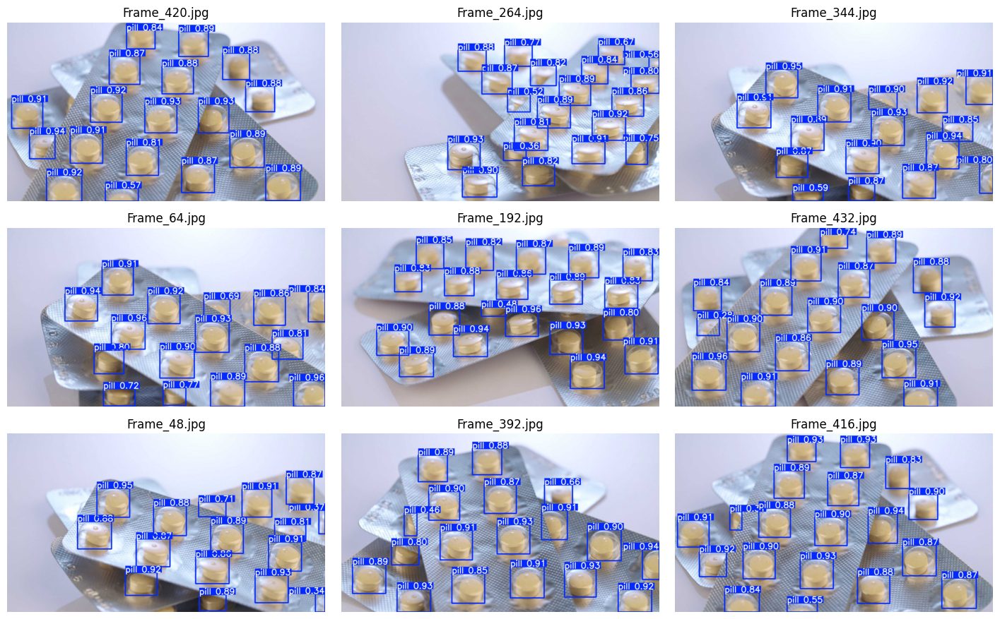

In [ ]:
# display first 9
folder = '/content/runs/detect/predict2'
images = [f for f in os.listdir(folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))][:9]

fig, axes = plt.subplots(3, 3, figsize=(18, 11))

for i, filename in enumerate(images):
    path = os.path.join(folder, filename)
    img = PILImage.open(path)
    w, h = img.size
    resized = img.resize((w // 2, h // 2))

    ax = axes[i // 3, i % 3]
    ax.imshow(resized)
    ax.axis('off')
    ax.set_title(filename[:20])

plt.subplots_adjust(wspace=0.05, hspace=0.1)
plt.show()

**Train YOLO11 Nano on VisDrone Dataset**

In [ ]:
# Download Data
path = kagglehub.dataset_download("kushagrapandya/visdrone-dataset")
print("Path to dataset files:", path)

100%|██████████| 2.10G/2.10G [01:43<00:00, 21.8MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/kushagrapandya/visdrone-dataset/versions/1


In [ ]:
src_path = path
dst_path = "/content/visdrone-dataset"

# Copy entire folder
shutil.copytree(src_path, dst_path)

print("Dataset is now in:", dst_path)

Dataset is now in: /content/visdrone-dataset


You need to modify the VisDrone.yaml file here.

In [ ]:
# Prepare Data
def visdrone2yolo(dir):
    def convert_box(size, box):
        dw, dh = 1. / size[0], 1. / size[1]
        x, y, w, h = box
        x_c = (x + w / 2) * dw
        y_c = (y + h / 2) * dh
        w_n = w * dw
        h_n = h * dh
        return x_c, y_c, w_n, h_n

    labels_dir = dir / 'labels'
    images_dir = dir / 'images'
    ann_dir = dir / 'annotations'
    if not ann_dir.exists():
        ann_dir = dir / 'labels'

    new_labels_dir = dir / 'labels'
    new_labels_dir.mkdir(parents=True, exist_ok=True)

    for f in tqdm(list(ann_dir.glob('*.txt')), desc=f'Converting {dir.name}'):
        img_path = images_dir / f.with_suffix('.jpg').name
        if not img_path.exists():
            continue
        img = Image.open(img_path)
        w, h = img.size
        lines = []
        with open(f) as ann:
            for line in ann:
                parts = line.strip().split(',')
                if len(parts) < 6 or parts[4] == '0':
                    continue
                cls = int(parts[5]) - 1
                box = tuple(map(int, parts[:4]))
                x, y, w_n, h_n = convert_box((w, h), box)
                lines.append(f"{cls} {x:.6f} {y:.6f} {w_n:.6f} {h_n:.6f}\n")
        with open(new_labels_dir / f.name, 'w') as out:
            out.writelines(lines)

# Convert both splits
for split in ['VisDrone2019-DET-train/VisDrone2019-DET-train',
              'VisDrone2019-DET-val/VisDrone2019-DET-val']:
    visdrone2yolo(Path(f"/content/visdrone-dataset/{split}"))


Converting VisDrone2019-DET-val: 100%|██████████| 548/548 [00:00<00:00, 1451.57it/s]


In [ ]:
# Load pretrained YOLOv11 Nano
model = YOLO("yolo11n.pt")

# Train on VisDrone
model.train(data="/content/visdrone-dataset/VisDrone.yaml", epochs=25, imgsz=640, batch=16)


In [ ]:
# Validate
model.val()
model.predict(model="/content/runs/detect/train3/weights/best.pt" , source="/content/visdrone-dataset/VisDrone2019-DET-val/VisDrone2019-DET-val/images", save=True)

**0000289_04201_d_0000832.jpg**

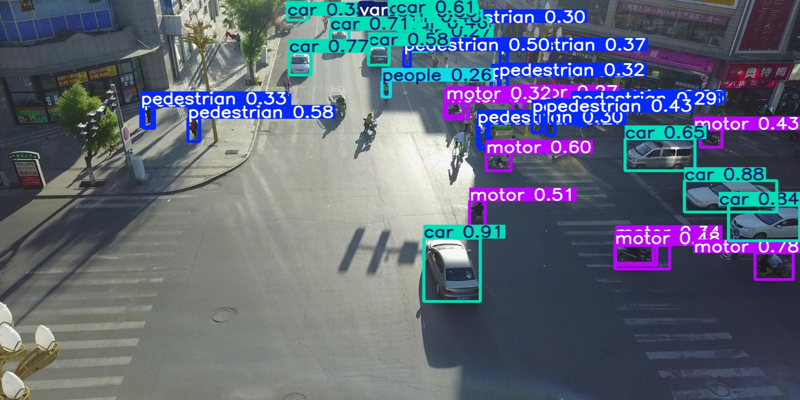

In [ ]:
folder = '/content/runs/detect/predict3'

# Display First Image
for i, filename in enumerate(os.listdir(folder)):
    if filename.lower().endswith(('.jpg', '.png', '.jpeg')):
        if i >= 1:
            break
        path = os.path.join(folder, filename)
        img = PILImage.open(path)
        resized = img.resize((800, 400))

        # Display filename
        display(Markdown(f"**{filename}**"))
        # Display image
        display(resized)

**Train YOLO11 Medium on VisDrone Dataset**

In [ ]:
# Load pretrained YOLOv11 Medium
model = YOLO("yolo11m.pt")

# Train on VisDrone
model.train(data="/content/visdrone-dataset/VisDrone.yaml", epochs=25, imgsz=640, batch=16)


In [ ]:
# Validate
model.val()
model.predict(model="/content/runs/detect/train4/weights/best.pt" , source="/content/visdrone-dataset/VisDrone2019-DET-val/VisDrone2019-DET-val/images", save=True)

**0000289_04201_d_0000832.jpg**

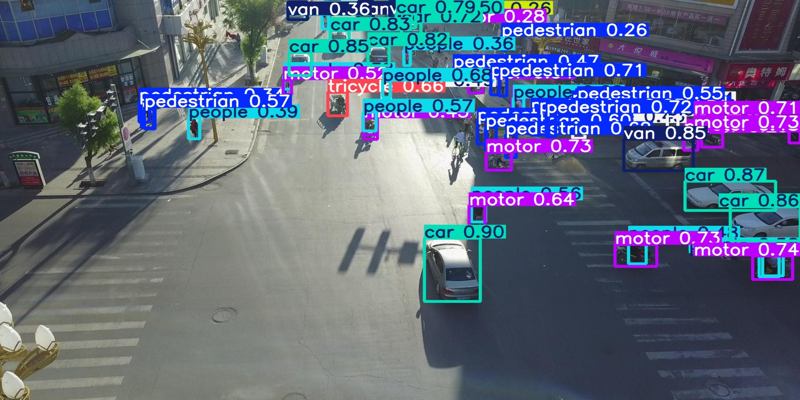

In [ ]:
folder = '/content/runs/detect/predict4'

# Display First Image
for i, filename in enumerate(os.listdir(folder)):
    if filename.lower().endswith(('.jpg', '.png', '.jpeg')):
        if i >= 1:
            break
        path = os.path.join(folder, filename)
        img = PILImage.open(path)
        resized = img.resize((800, 400))

        # Display filename
        display(Markdown(f"**{filename}**"))
        # Display image
        display(resized)

**Compare *YOLO11  Nano* and *YOLO11 Medium* Results for First 20 Images**

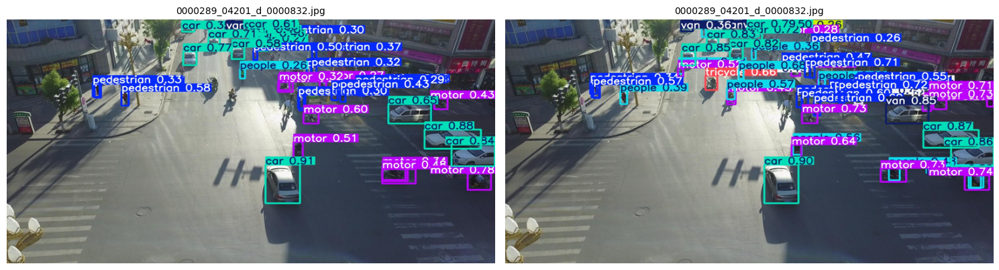

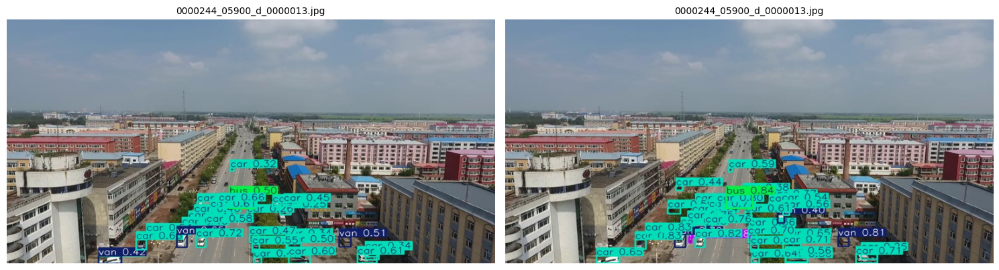

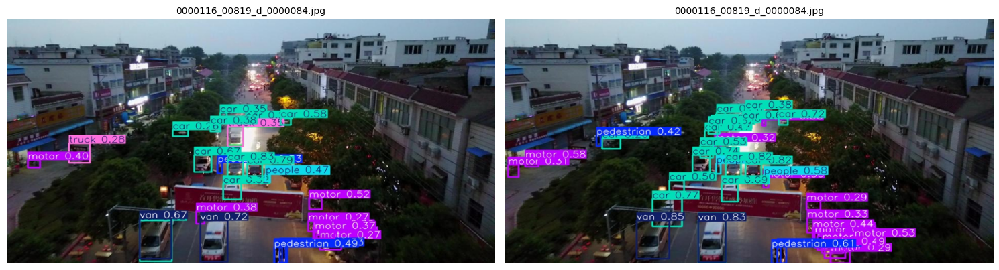

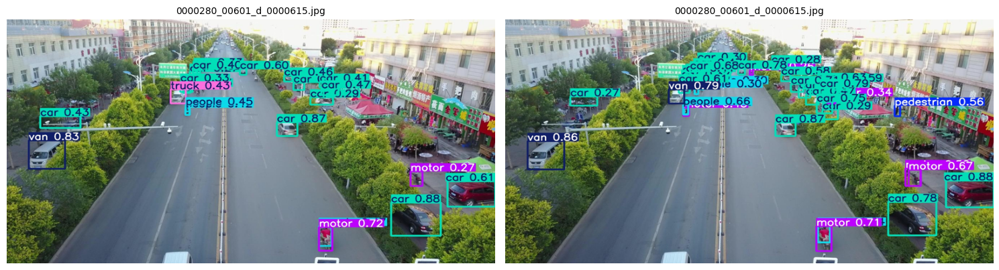

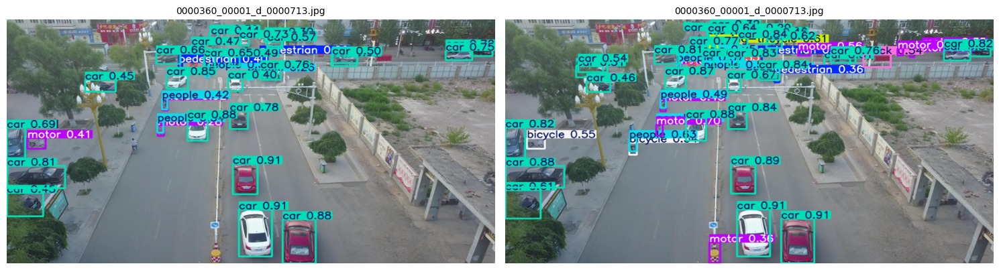

...

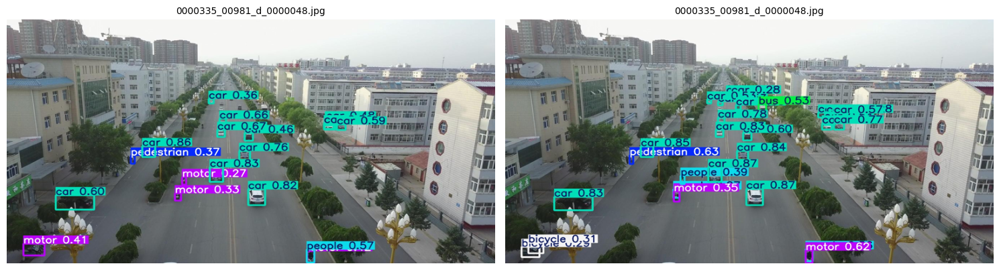

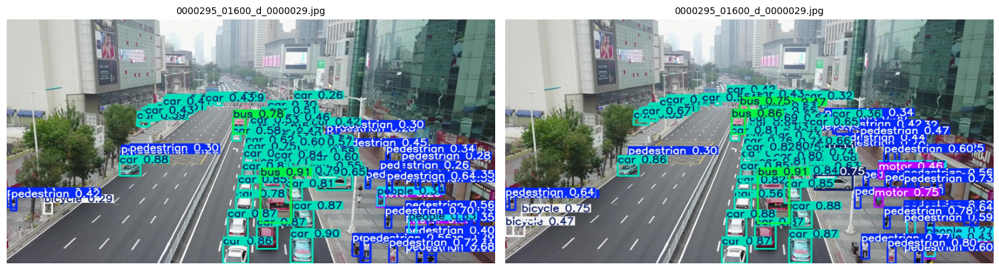

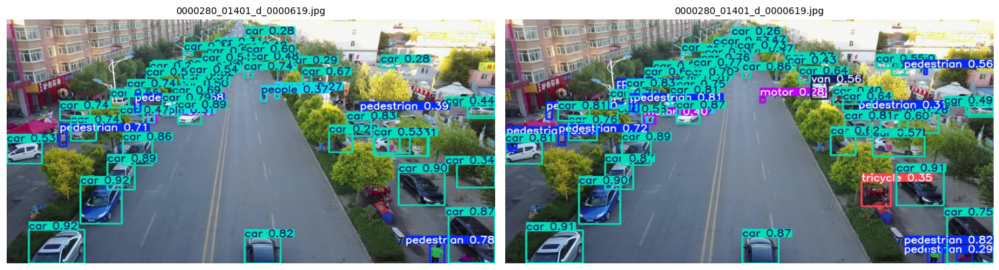

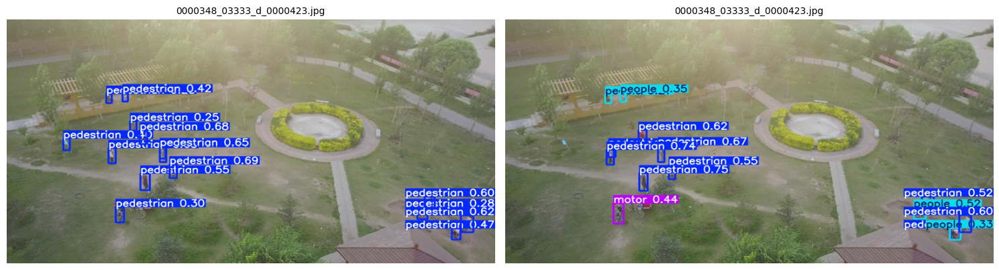

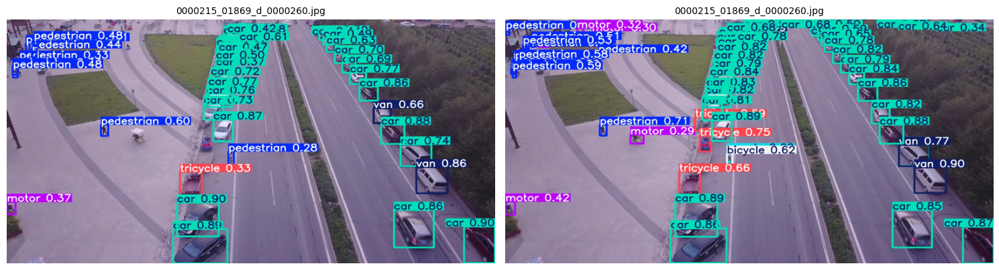

In [ ]:
folder1 = '/content/runs/detect/predict3'
folder2 = '/content/runs/detect/predict4'

images1 = [f for f in os.listdir(folder1) if f.lower().endswith(('.jpg', '.png', '.jpeg'))][:20]
images2 = [f for f in os.listdir(folder2) if f.lower().endswith(('.jpg', '.png', '.jpeg'))][:20]

# Display Images Side by Side (Left:Nano, Right: Medium)
for f1, f2 in zip(images1, images2):
    path1 = os.path.join(folder1, f1)
    path2 = os.path.join(folder2, f2)

    img1 = PILImage.open(path1).resize((800, 400))
    img2 = PILImage.open(path2).resize((800, 400))

    fig, axes = plt.subplots(1, 2, figsize=(15, 5))
    axes[0].imshow(img1)
    axes[0].set_title(f1, fontsize=10)
    axes[0].axis('off')

    axes[1].imshow(img2)
    axes[1].set_title(f2, fontsize=10)
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()
